Условие 1: Задача 1
Постройте график
Назовите график
Сделайте именование оси x и оси y
Сделайте выводы

1.1. Скачать данные по ссылке https://www.kaggle.com/datasets/ionaskel/laptop-prices  
**(ССЫЛКА НЕ РАБОЧАЯ, ВЗЯТ ДАТАФРЕЙМ ПО ДОМАМ ИЗ СЕМИНАРОВ)

1.2 Изучите стоимости недвижимости
1.3 Изучите распределение квадратуры жилой

In [92]:
import pandas as pd

In [93]:
import matplotlib.pyplot as plt
import seaborn as sns

In [94]:
df = pd.read_csv('kc-house-data.csv', encoding ="1251")

In [43]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [44]:
df['price'].min()

75000.0

In [45]:
df['price'].max()

7700000.0

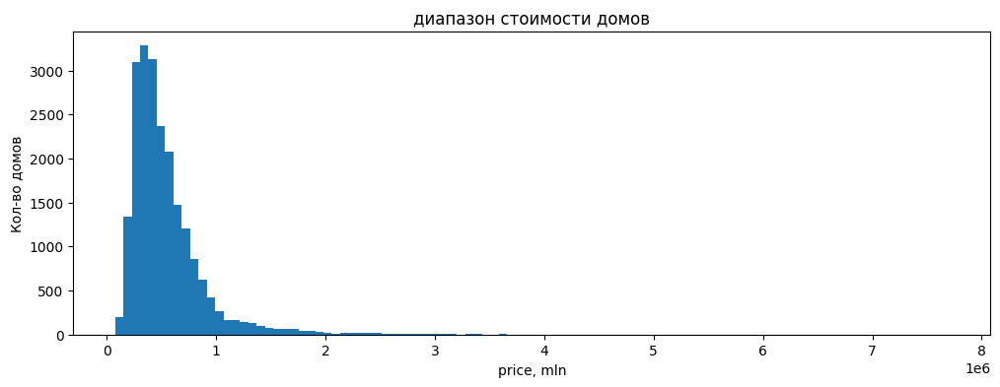

In [56]:
plt.figure(figsize=(12, 4))
plt.hist(df['price'],bins=100)
plt.title('диапазон стоимости домов')
plt.xlabel('price, mln')
plt.ylabel('Кол-во домов');


максимальное кол-во домов лежат в диапазоне от 250К до 1000К

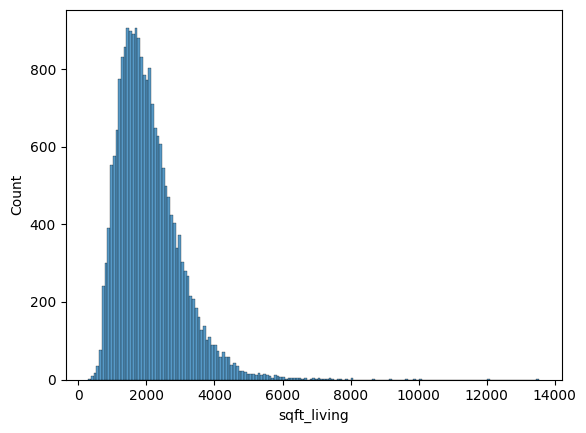

In [58]:
sns.histplot(data=df, x='sqft_living');

максимальное кол-во домов лежат в диапазоне площади от 1000 до 3000 sq ft

2.1.4 Изучите распределение года постройки

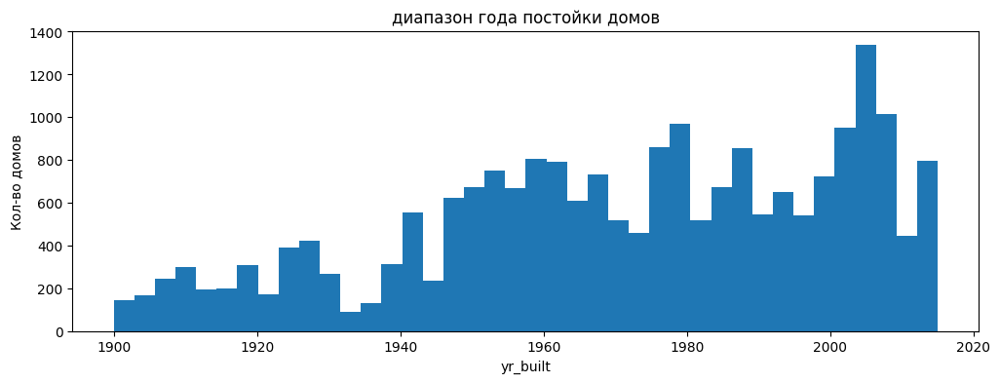

In [64]:
plt.figure(figsize=(12, 4))
plt.hist(df['yr_built'],bins=40)
plt.title('диапазон года постойки домов')
plt.xlabel('yr_built')
plt.ylabel('Кол-во домов');

Основная масса домов построена в годы с 1950 по 2015, с пиком в 2005 году

In [ ]:
Изучите распределение домов от наличия вида на набережную, Постройте график, Сделайте выводы

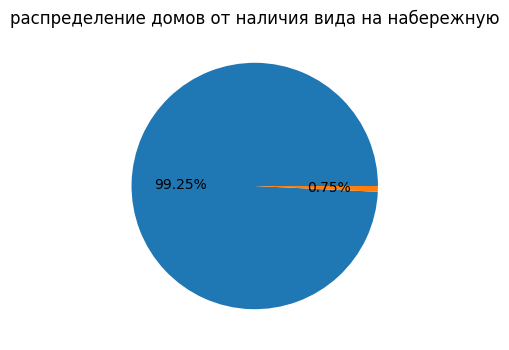

In [69]:
data=df['waterfront'].value_counts(normalize  =True)
plt.figure(figsize=(6, 4))
plt.pie(data, autopct='%.2f%%')
plt.title('распределение домов от наличия вида на набережную');

менее 1% домов имеют вид на набережную

In [ ]:
2.2 Изучите распределение этажей домов

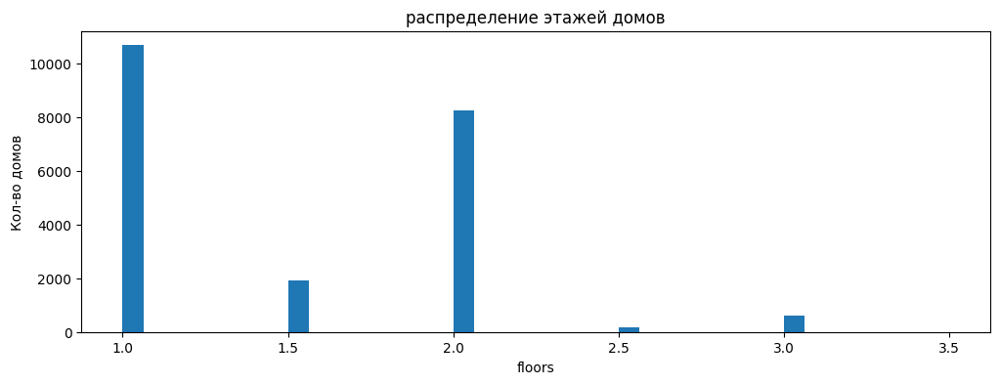

In [71]:
plt.figure(figsize=(12, 4))
plt.hist(df['floors'],bins = 40)
plt.title('распределение этажей домов')
plt.xlabel('floors')
plt.ylabel('Кол-во домов');


In [ ]:
наибольшее кол-во одноэтажных домов, на втором месте двухэтажные.

In [ ]:
2.2 Изучите распределение состояния домов

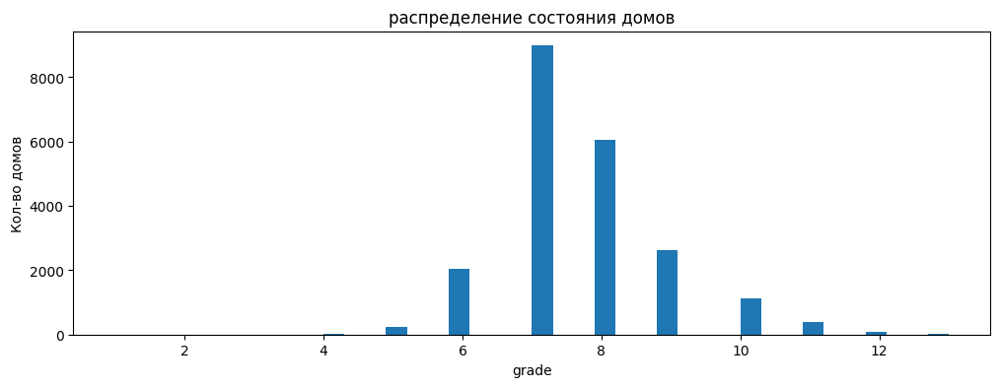

In [72]:
plt.figure(figsize=(12, 4))
plt.hist(df['grade'],bins = 40)
plt.title('распределение состояния домов')
plt.xlabel('grade')
plt.ylabel('Кол-во домов');

In [ ]:
наибольшее кол-во домов с оценкой состояния 7 и 8

In [ ]:
Условие 3: 3 задача
Исследуйте, какие характеристики недвижимости влияют на стоимость недвижимости, с применением не менее 5 диаграмм из урока.
Анализ сделайте в формате storytelling: дополнить каждый график письменными выводами и наблюдениями.

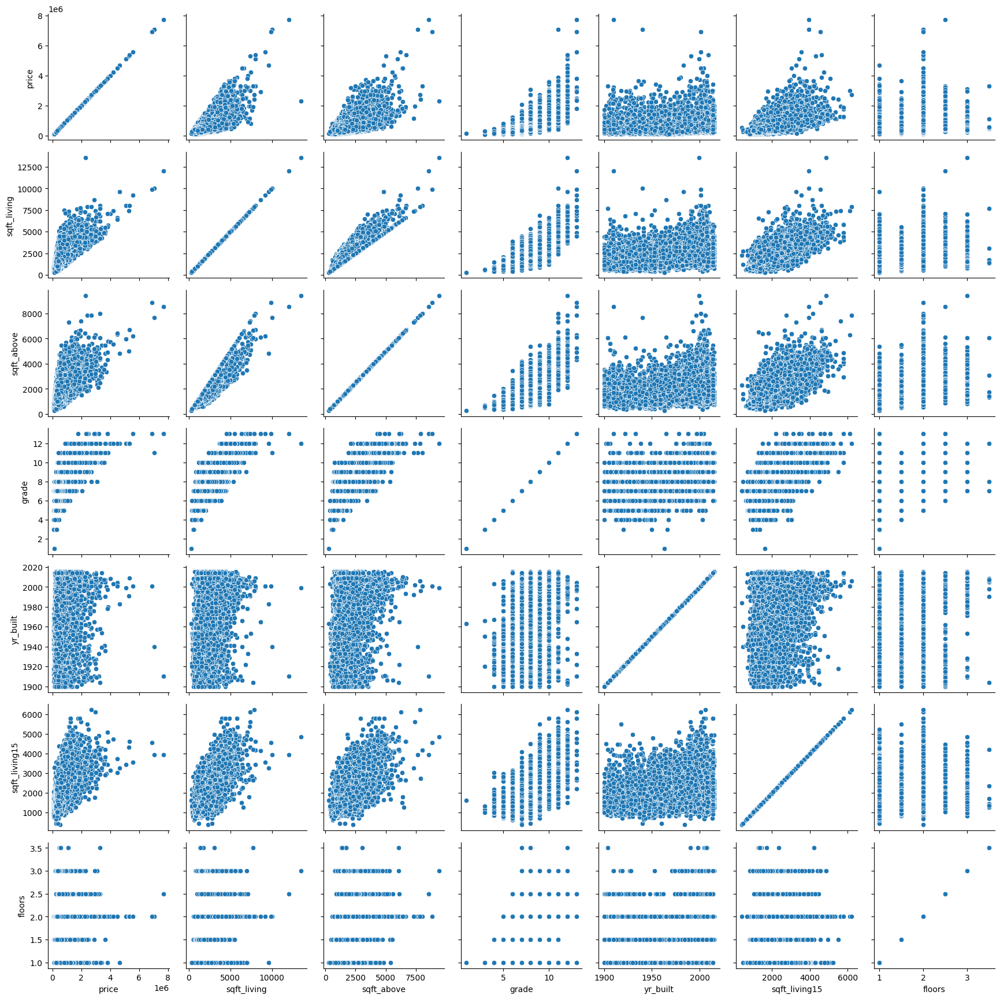

In [116]:
data=['price', 'sqft_living','sqft_above','grade','yr_built','sqft_living15','floors']
g = sns.PairGrid(df[data])
g.map(sns.scatterplot);

C:\Users\hp\AppData\Local\Temp\ipykernel_26316\3386720731.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


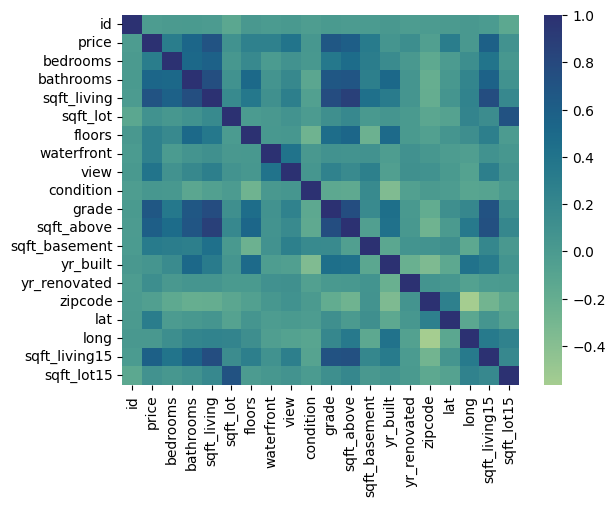

In [99]:
corr_matrix = df.corr()
sns.heatmap(corr_matrix,cmap='crest');

на основе тепловой карты корреляции, цена домов больше всего зависит от размера жилой площади, уровня оценки недвижимости, размер жилой площади у 15 ближайших соседей и площаь дома (без площади помещений фундамента, цоколя)

In [83]:
import folium
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(
        location=[point.lat, point.long],
        radius=2,
        popup=point.price
    ).add_to(this_map)
    
df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map

Расположил координаты домов на карте, это корестности Сиэтла, штат Вашингтон, сделаны выноски с указанием цены

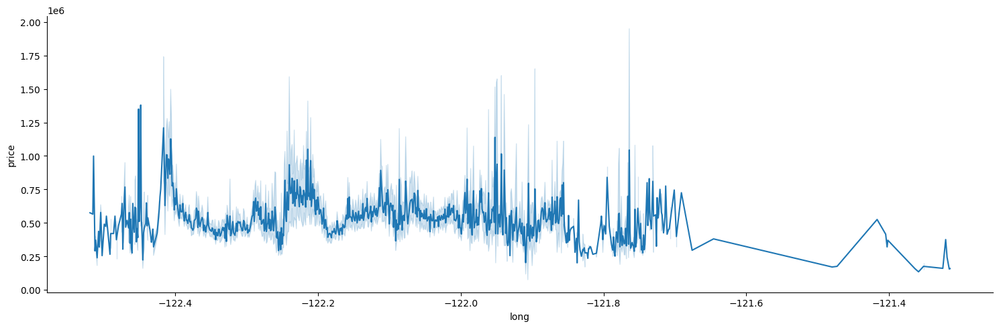

In [118]:
sns.relplot(data=df, x="long", y="price",kind = 'line', height = 5, aspect = 3)

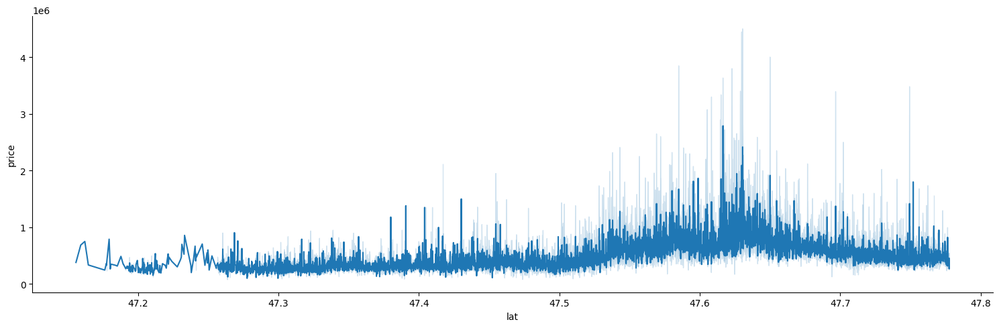

In [119]:
sns.relplot(data=df, x="lat", y="price",kind = 'line', height = 5, aspect = 3)

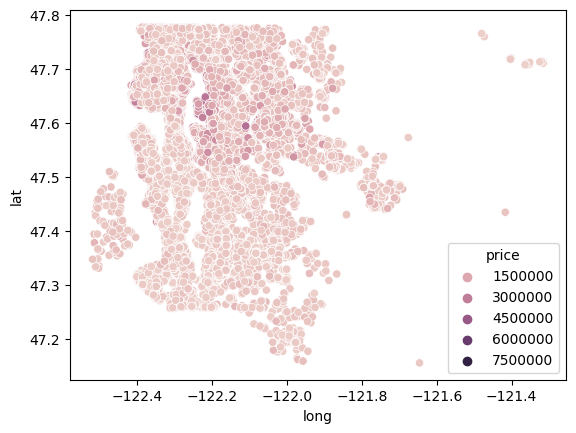

In [125]:
sns.scatterplot(data=df,x='long', y='lat', hue = 'price');

In [126]:
df.pivot_table(index='condition',columns='grade',values='price',aggfunc='median',fill_value=0)

grade,1,3,4,5,6,7,8,9,10,11,12,13
condition,,,,,,,,,,,,
1,142000,0,150000,190000,255000,403500,932500,0,0,0,0,0
2,0,280000,145000,180000,235000,305000,429000,715000,1752500,0,0,0
3,0,75000,205000,234475,265000,357500,485000,689000,890000,1209500,1807500,2888000
4,0,0,238525,229975,295000,390000,571250,823500,1030000,1685000,2125000,5750000
5,0,262000,0,227450,285475,456000,696000,1078000,1650000,2050000,1990000,0


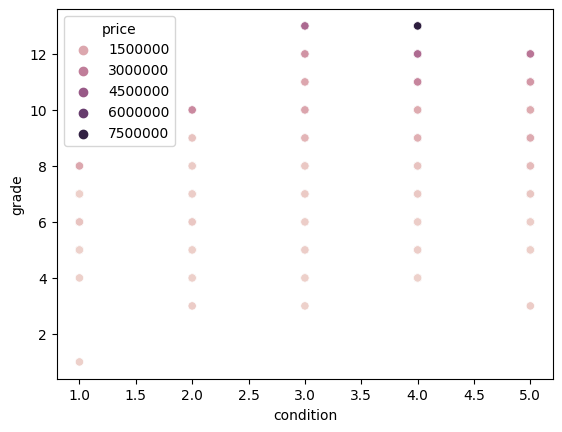

In [128]:
sns.scatterplot(data=df,x='condition', y='grade', hue = 'price');

есть определенная зависимость цены от оценки состояния недвижимости и grade, но только когда grade выше 8 и состояние выше 4

In [102]:
data=df.groupby('grade').agg({'price':'mean'}).sort_values('price')
data

,price
grade,
1,1.420000e+05
3,2.056667e+05
4,2.143810e+05
5,2.485240e+05
6,3.019196e+05
7,4.025903e+05
8,5.428528e+05
9,7.735132e+05
10,1.071771e+06


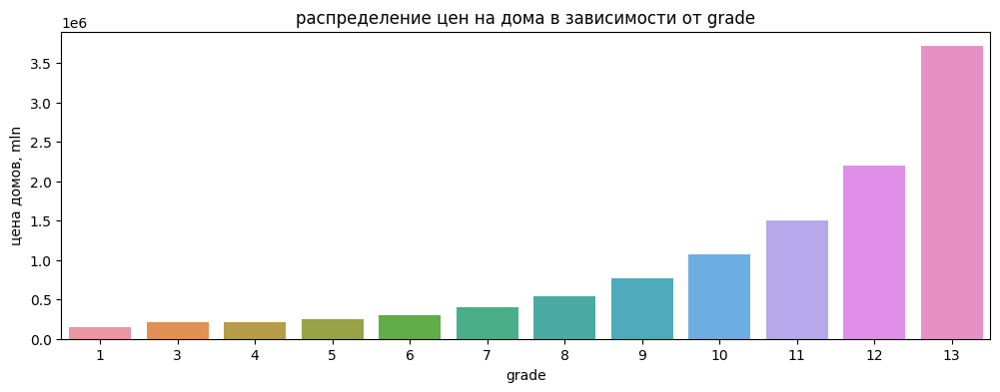

In [105]:
plt.figure(figsize=(12, 4))
sns.barplot(x=data.index,y=data.price)
plt.title('распределение средних цен на дома в зависимости от grade')
plt.xlabel('grade')
plt.ylabel('цена домов, mln');

наблюдается явная прямая зависимость, средняя цена на дом выше, чем выше grade.

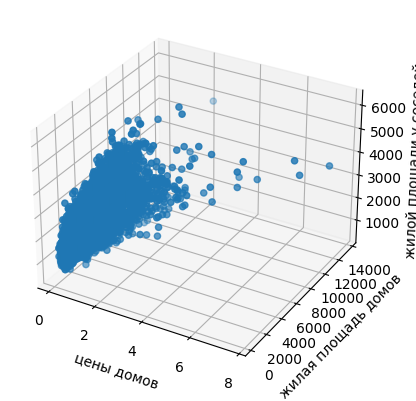

In [110]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection = '3d')
x = df['price']
y = df['sqft_living']
z = df['sqft_living15']

ax.set_xlabel("цены домов")
ax.set_ylabel("жилая площадь домов")
ax.set_zlabel("жилой площади у соседей")

ax.scatter(x, y, z)

plt.show()

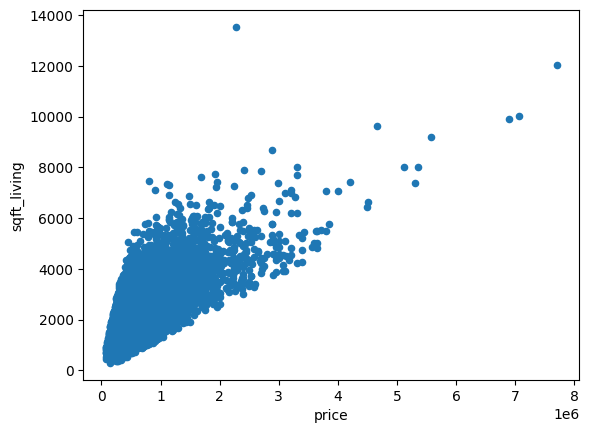

In [113]:

df.plot(x="price", y="sqft_living", kind="scatter");

In [ ]:
есть зависимость цены дома от жилой площади, однако зависимость не прямолинейная и лежит примерно в диапазоне зависимостей функций от y=2x до y=3/2x

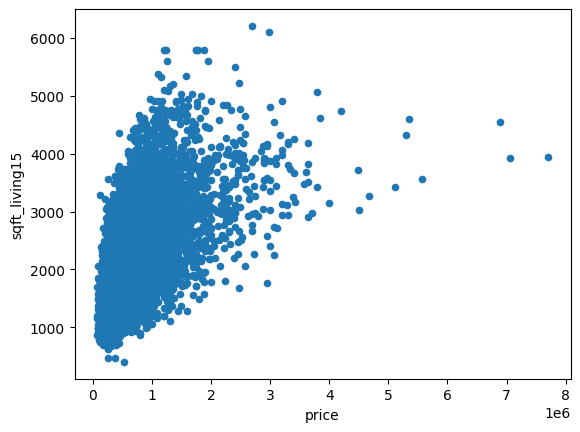

In [114]:
df.plot(x="price", y="sqft_living15", kind="scatter");

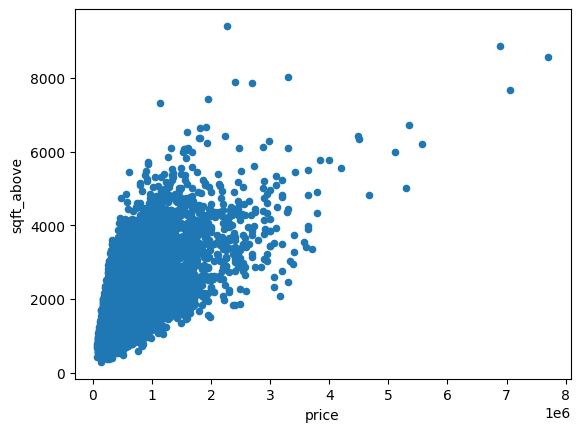

In [115]:
df.plot(x="price", y="sqft_above", kind="scatter");

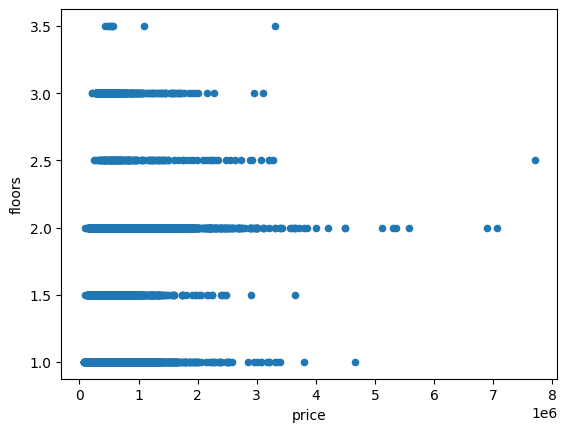

In [117]:
df.plot(x="price", y="floors", kind="scatter");

дома свыше 3,5 млн это двухэтажные дома, выпросами по одноэтажным и 2,5 этажным можно принебречь 

In [ ]:
Выводы по датафрейму:
Предложенный датафрейм с данными по домам. Дома расположены в окрестностях Сиэтла, штат Вашингтон. 
Дома расположены как на материке, так и на островах. Прямой зависимости от расположения, широты долготы, 
наличия вида и расположения на побережье не найдено, при этом на набережной расположено около 0,75% домов.
Минимальная стоимость дома составляет 75000, максимальная 7700000, разница более чем в 10раз.
Максимальное кол-во домов лежат в диапазоне стоимости от 250К до 1000К, с жилой площадью  от 1000 до 3000 кв. футов.
Большая часть одноэтажных домов, на втором месте двухэтажные. состояние домов по оценке grade - выше 5, 
при этом большая часть с оценкой 7 и 8.
На основе тепловой карты корреляции, цена домов больше всего зависит от:
    - размера жилой площади, 
    - уровня оценки недвижимости,
    - размера жилой площади у 15 ближайших соседей
    - площади дома (без площади помещений фундамента, цоколя)
При этом явная прямая зависимость: средняя цена на дом выше, чем выше grade.
Зависимость цены дома от жилой площади не прямолинейная и лежит примерно в диапазоне зависимостей функций от y=2x до y=3/2x.
Зависимость от размера жилой площади у 15 ближайших соседей и площади дома без фундамента еще менее прямолинейна.
Есть определенная зависимость цены от оценки состояния недвижимости и grade, но только когда grade выше 8 и состояние выше 4
Дома свыше 3,5 млн это двухэтажные дома.